# Advanced Computer Vision for Artificial Intelligence Assignment
## Task 1: Dataset Annotation Visualisation

### Installing and Importing Necessary Packages

In [ ]:
!pip install roboflow

In [ ]:
import os
import cv2
from matplotlib import pyplot as plt
import matplotlib.patches as patches
from PIL import Image, ImageDraw, ImageFont
import numpy as np
from roboflow import Roboflow

### Downloading the dataset from Roboflow

In [ ]:
# Downloading the dataset from Roboflow in YOLOv8 format
rf = Roboflow(api_key="M11OK0bZkXvcy3y2hb2k")
project = rf.workspace("computer-vision-2024-assignment").project("waste-bag-detection")
version = project.version(3)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Waste-Bag-Detection-3 in yolov8:: 100%|██████████| 1934/1934 [00:03<00:00, 554.44it/s] 


### Loading Images

#### Function which loads images from the given path

In [ ]:
def load_imgs(path, no_of_images, img_size=(960,960), do_display=False):
    # Declaring necessary variables
    images = {}
    image_paths = []

    # Iterating through all images in the given path
    for img_no, img_name in enumerate(os.listdir(path)):
        # Breaking from loop if no_of_images is reached
        if img_no == no_of_images:
            break

        # Loading, resizing and storing images in a dictionary
        image_paths.append(os.path.join(path, img_name))
        img = Image.open(os.path.join(path, img_name))
        img = img.resize(img_size)
        images[img_no] = img

        # Displaying images if do_display is True
        if do_display:
            print('Image {}  Image name: {}'.format(img_no+1, img_name))
            display(img)

    # Returning images and image paths
    return images, image_paths

In [ ]:
# Specifying path to the images
image_path = 'Waste-Bag-Detection-3/test/images'  # replace 'test' with 'train'/'valid' depending on which split you want to visualise
no_of_images = len([image for image in os.listdir(image_path)]) #None
do_display = False

# Loading images
images, image_paths = load_imgs(path=image_path, no_of_images=no_of_images, do_display=do_display)

**<h3>Loading Annotations</h3>**

**<h4>Function to convert bounding box coordinates from YOLOv8 format to PIL format</h4>**

In [ ]:
def convert_bbox(coordinates, image_width, image_height):
    # Unpacking coordinates from YOLOv8 format
    x_center, y_center, width, height = coordinates

    # Calculating new width and height
    new_width = width * image_width
    new_height = height * image_height

    # Calculating new center
    new_x_center = x_center * image_width
    new_y_center = y_center * image_height

    # Calculating new coordinates
    new_x1 = int(new_x_center - (new_width / 2))
    new_y1 = int(new_y_center - (new_height / 2))
    new_x2 = int(new_x_center + (new_width / 2))
    new_y2 = int(new_y_center + (new_height / 2))

    # Returning new coordinates
    return [new_x1, new_y1, new_x2, new_y2]

**<h4>Function which loads annotations from the given path</h4>**

In [ ]:
def load_annotations(path, labels, no_of_annotations, do_display=False):
    # Declaring necessary variables
    annotations = {}

    # Iterating over all files in the directory
    for filename in os.listdir(path):
        # Breaking from loop if no_of_annotations is reached
        if len(annotations) == no_of_annotations:
            break

        # Displaying filename if do_display is True
        if do_display:
            print('Filename: {}'.format(filename))

        # Constructing the full file path
        file_path = os.path.join(path, filename)

        # Removing the final file extension from the filename
        filename = filename.rsplit('.', 1)[0]

        # Declaring empty list for the current filename
        annotations[filename] = []

        # Opening the file and reading its contents
        with open(file_path, 'r') as file:
        # Iterating through each line in the file
            for line in file:
                # Splitting the line into label and coordinates
                parts = line.strip().split(' ')
                label = labels[int(parts[0])]
                coordinates = [float(coord) for coord in parts[1:]]

                # Storing the data in the dictionary
                annotations[filename].append({label: coordinates})

                # Displaying annotations if do_display is True
                if do_display:
                    print('Label:' + ' {}'.format(label) + ' Coordinates:' + ' {}'.format(coordinates))

        if do_display:
            print()

    # Returning annotations
    return annotations

In [ ]:
# Defining Labels
LABELS ={
    0: "Mixed",
    1: "Organic-Green",
    2: "Organic-White",
    3: "Other",
    4: "Recyclable",
    5: "Recyclable-Cyan",
    6: "Recyclable-DarkGrey",
    7: "Recyclable-Green",
}

In [ ]:
# Specifying path to the annotation labels
annotation_path = 'Waste-Bag-Detection-3/test/labels' # replace 'test' with 'train'/'valid' depending on which split you want to visualise
no_of_annotations = None
do_display = False

# Loading annotations
annotations = load_annotations(path=annotation_path, labels=LABELS, no_of_annotations=no_of_annotations, do_display=do_display)

**<h3>Plotting Annotations on Images</h3>**

In [ ]:
# Defining constant label colors, which will be used to draw bounding boxes and are in BGR format
LABEL_COLORS = {
    'Mixed': (255, 0, 0),  # Blue
    'Organic-White': (255, 220, 0),  # Yellow
    'Recyclable': (0, 0, 255),  # Red
    'Organic-Green': (255, 0, 255),  # Magenta
    'Recyclable-Cyan': (0, 255, 255),  # Cyan
    'Recyclable-DarkGrey': (128, 128, 128),  # Gray
    'Recyclable-Green': (128, 0, 128),  # Purple
    'Other': (0, 0, 0),  # Black
}

**<h4>Function which plots annotations on images</h4>**

In [ ]:
def plot_image_annotations(image_paths, annotations, label_colors, target_size, do_display=False, text_display=True, font_scale=1, alpha=0.4):
    # Iterating through all the images
    for img_no, image_path in enumerate(image_paths):
        # Retrieving the image
        image_path = image_paths[img_no]

        # Reading the image
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, target_size)

        # Retrieving the image name
        image_name = image_path.split('/')[-1]
        image_name = image_name.split('\\')[-1]

        # Removing only last file extension from the image name
        image_name = image_name.rsplit('.', 1)[0]

        # Retrieving the image annotations
        image_annotations = annotations[image_name]

        # Drawing the bounding boxes around the image
        for annotation in image_annotations:
            # Retrieving the label and coordinates of the bounding box
            label = list(annotation.keys())[0]
            bbox = annotation[label]

            # Converting the bounding box coordinates from YOLOv8 format to PIL format
            bbox = convert_bbox(bbox, target_size[0], target_size[1])

            # Retrieving the coordinates of the bounding box
            x1, y1, x2, y2 = bbox

            # Creating a copy of the image
            image_with_rectangle = image.copy()

            # Creating a filled rectangle for the bounding box
            cv2.rectangle(image_with_rectangle, (x1, y1), (x2, y2), label_colors[label], cv2.FILLED)

            # Blending the image with the rectangle using cv2.addWeighted
            image = cv2.addWeighted(image, 1 - alpha, image_with_rectangle, alpha, 0)

            # Adding a rectangle outline to the image
            cv2.rectangle(image, (x1, y1), (x2, y2), label_colors[label], 3)

            # Adding the label to the image
            if text_display:
                # Setting the font
                font = cv2.FONT_HERSHEY_SIMPLEX

                # Drawing the label on the image, whilst ensuring that it doesn't go out of bounds
                (label_width, label_height), baseline = cv2.getTextSize(label, font, font_scale, 2)

                # Ensuring that the label doesn't go out of bounds
                if y1 - label_height - baseline < 0:
                    y1 = label_height + baseline
                if x1 + label_width > image.shape[1]:
                    x1 = image.shape[1] - label_width
                if y1 + label_height + baseline > image.shape[0]:
                    y1 = image.shape[0] - label_height - baseline
                if x1 < 0:
                    x1 = 0

                # Creating a filled rectangle for the label background
                cv2.rectangle(image, (x1, y1 - label_height - baseline), (x1 + label_width, y1), label_colors[label], -1)

                # Adding the label text to the image
                cv2.putText(image, label, (x1, y1 - 5), font, font_scale, (255, 255, 255), 2, cv2.LINE_AA)

        # Displaying images with annotations if do_display is True
        if do_display:
            plt.figure(figsize=(10,10))
            plt.imshow(image)
            plt.axis('off')
            plt.show()

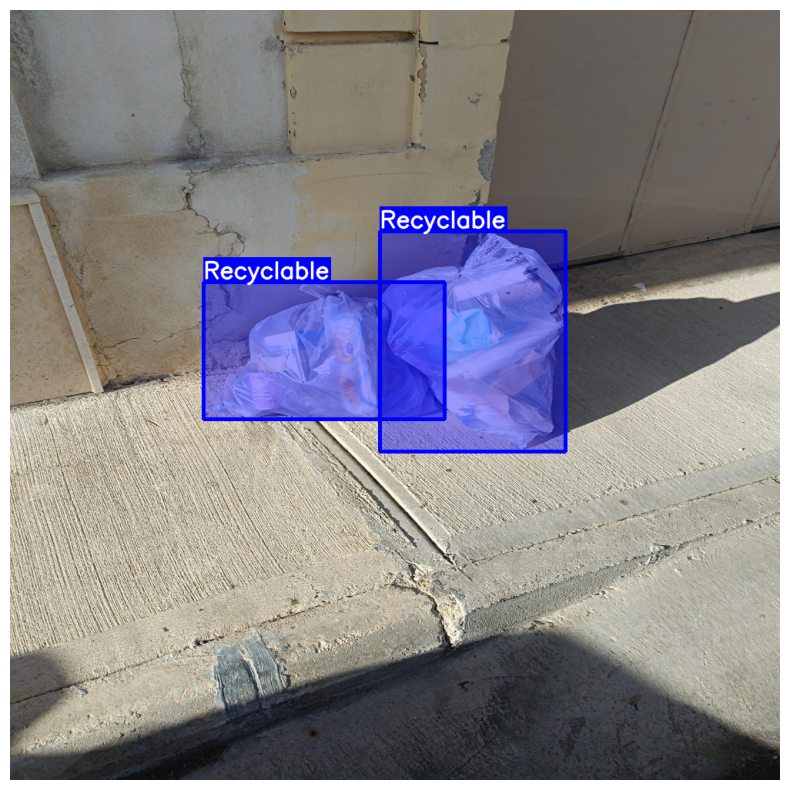

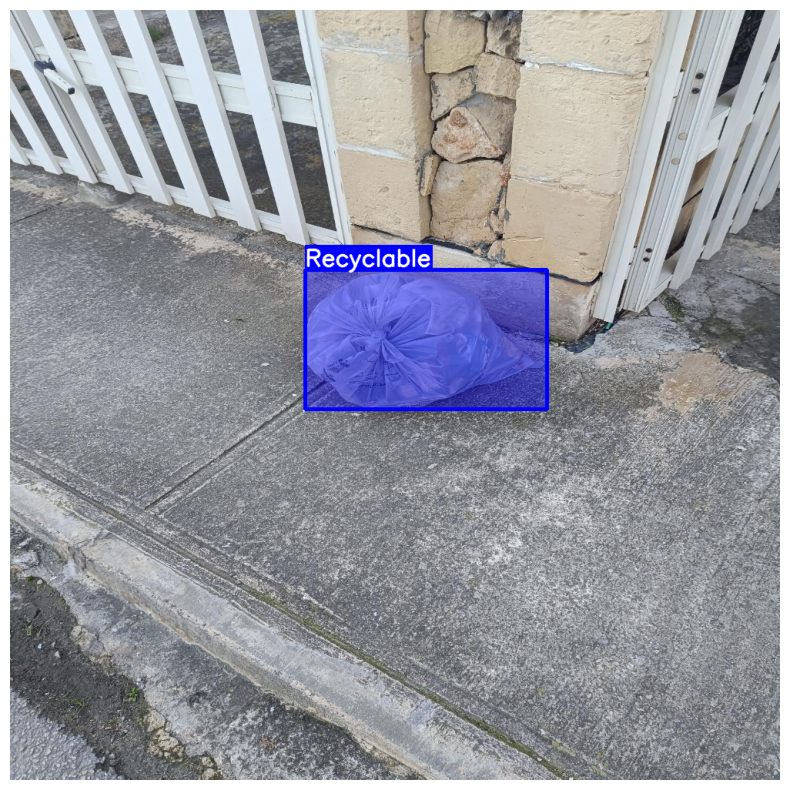

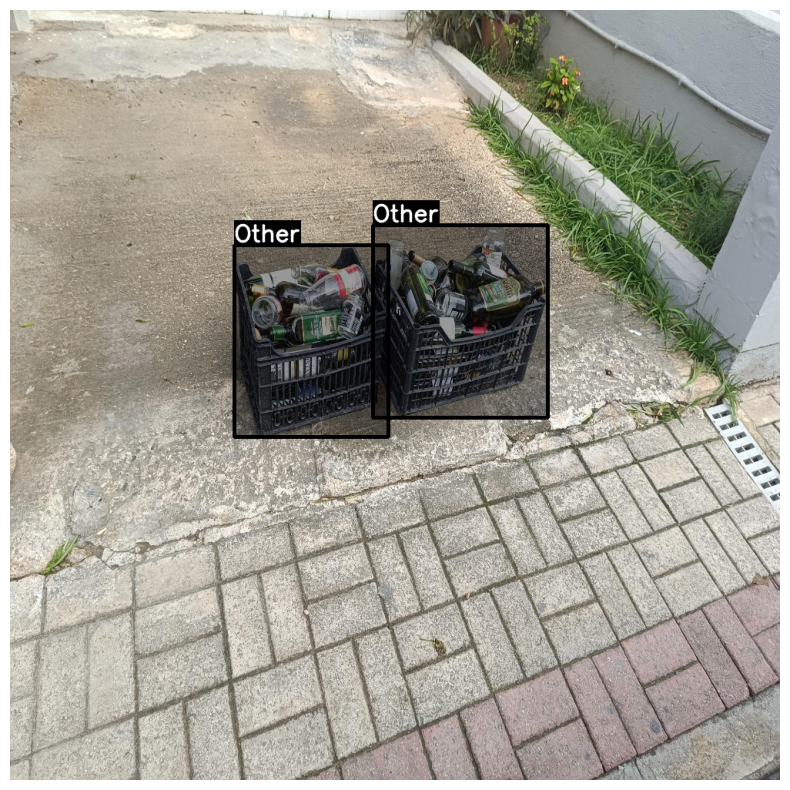

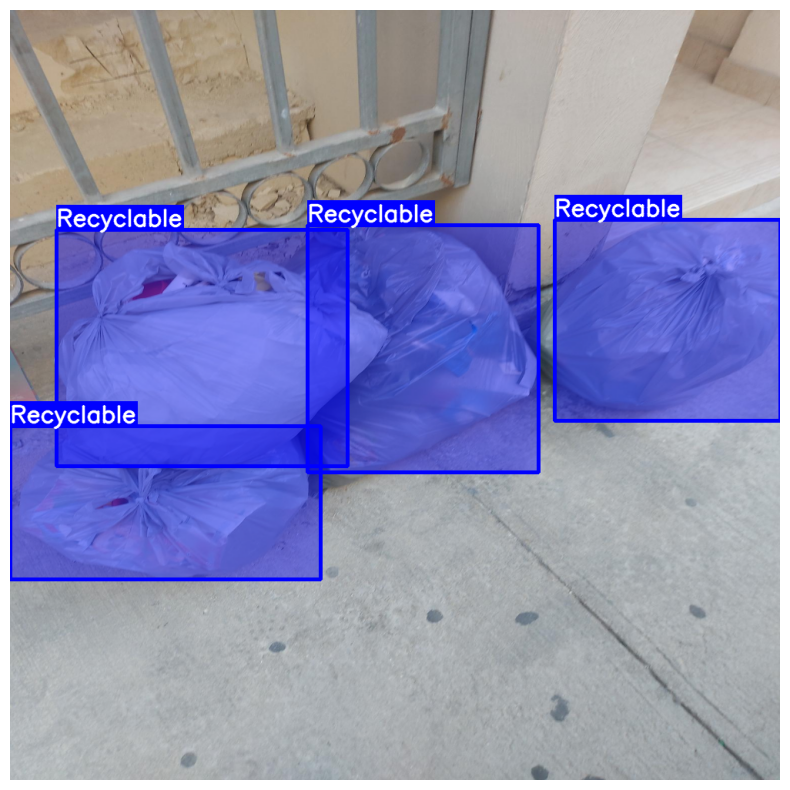

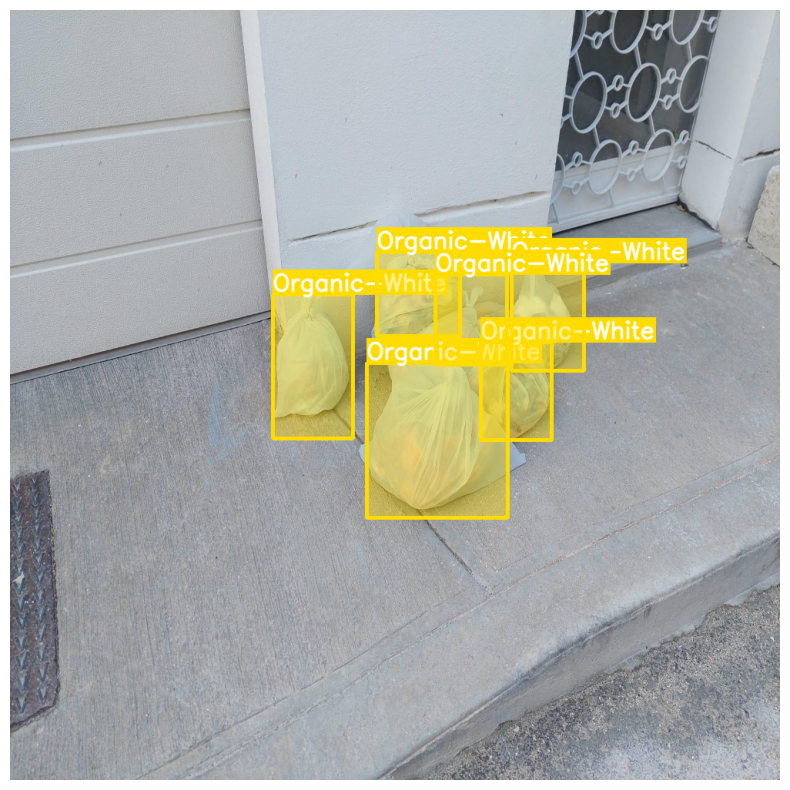

...

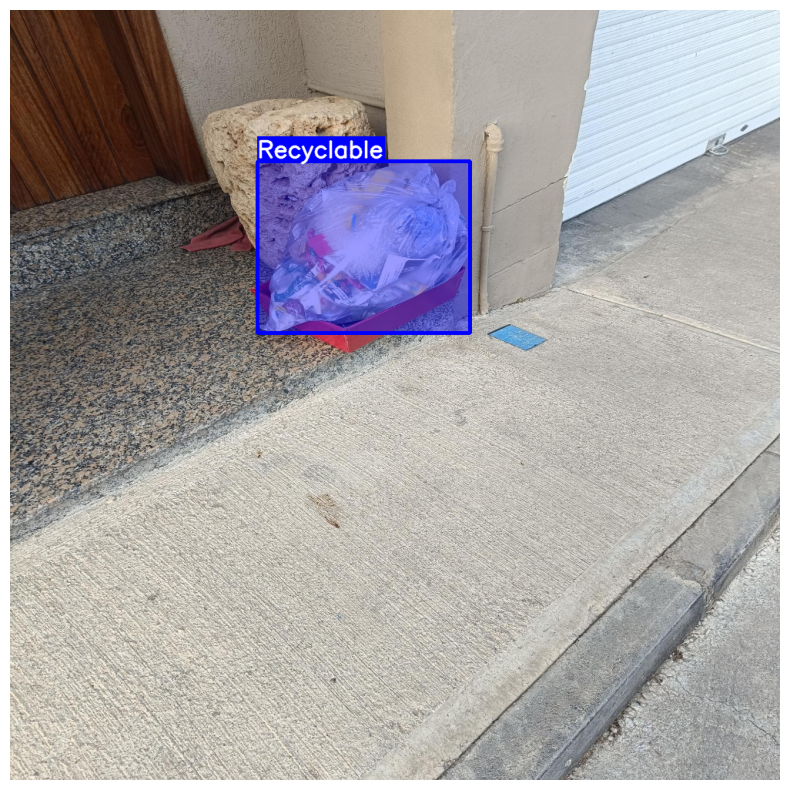

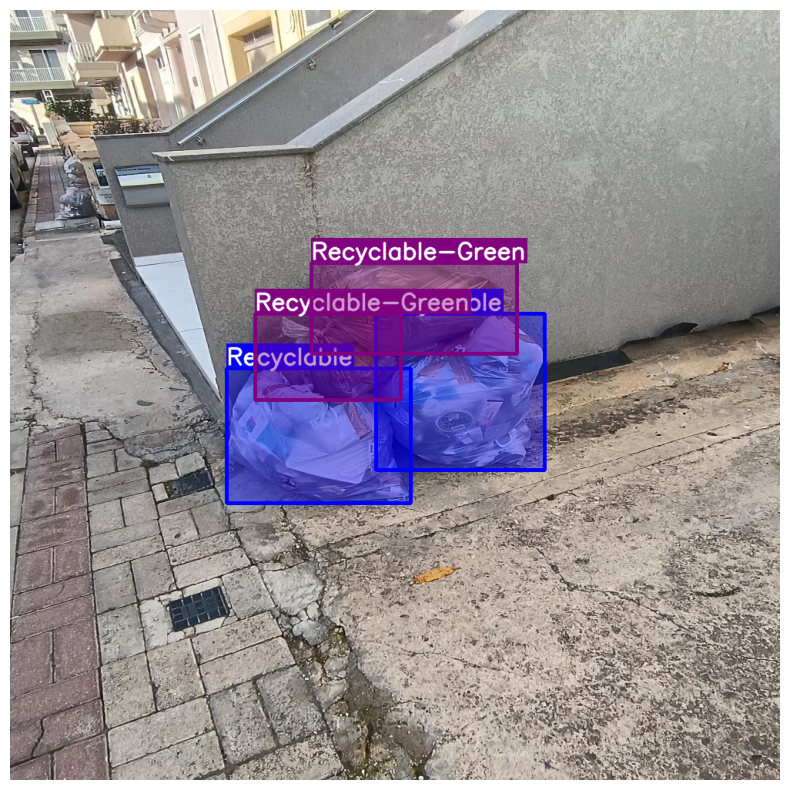

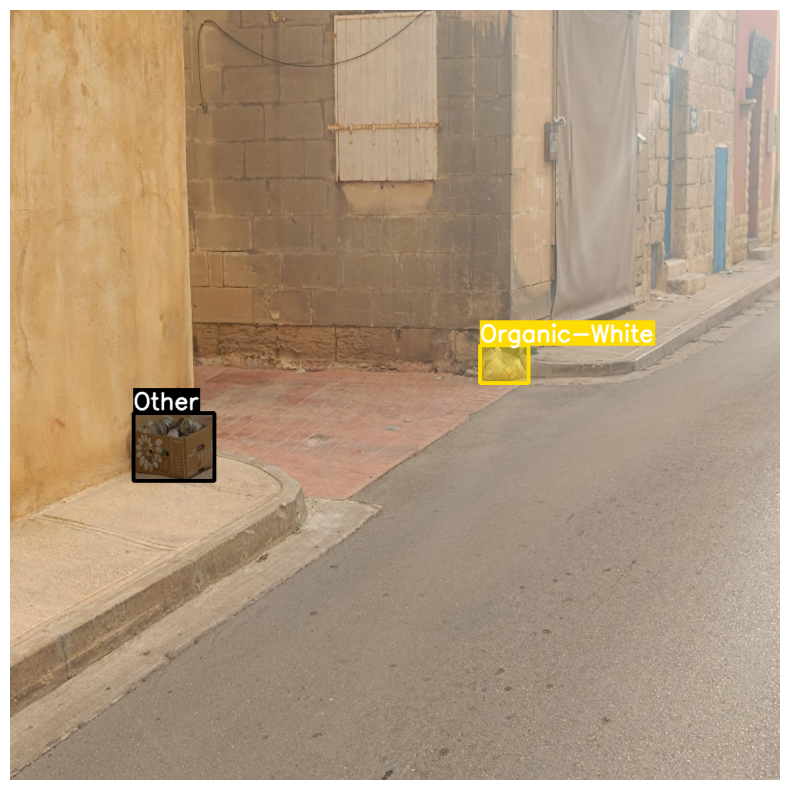

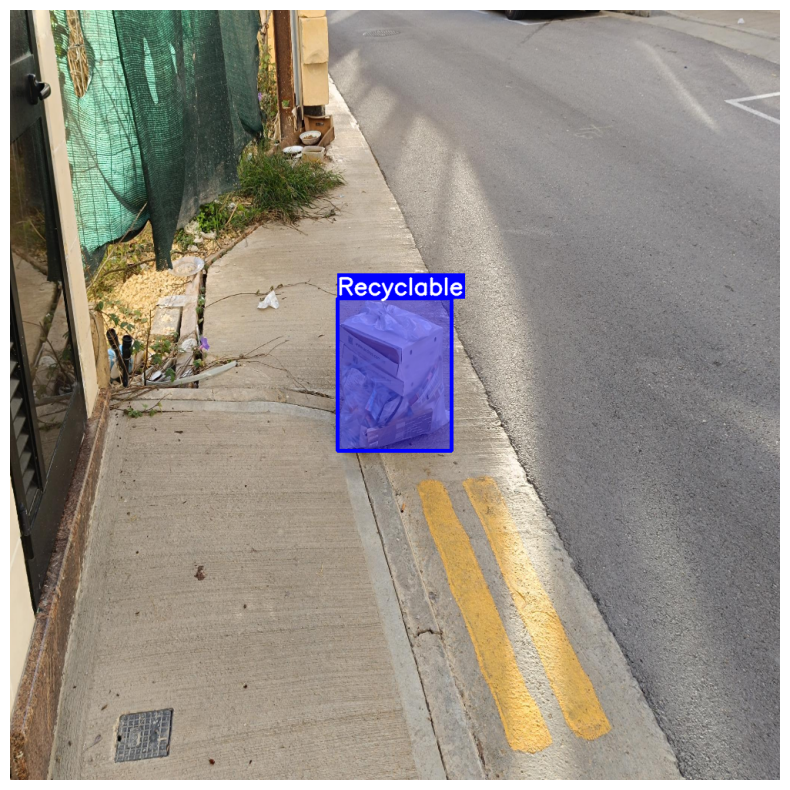

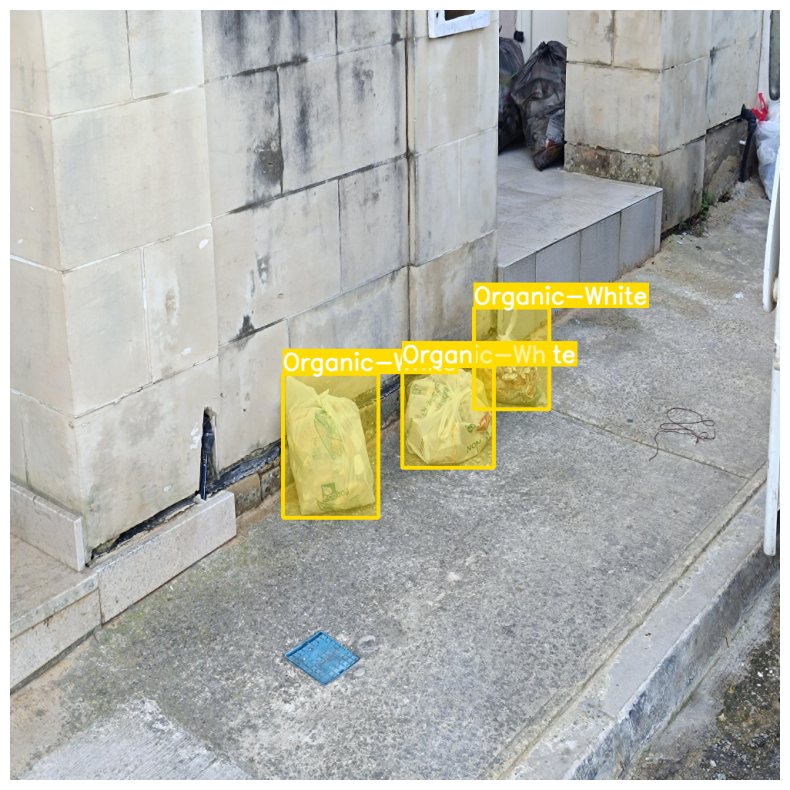

In [ ]:
# Specifying options
do_display = True

# Plotting images with annotations
plot_image_annotations(image_paths=image_paths, annotations=annotations, label_colors=LABEL_COLORS, target_size=(1000, 1000) , do_display=do_display)